## Setup

In [1]:
import jax

In [2]:
num_devices = jax.device_count()
device_type = jax.devices()[0].device_kind

print(f"Found {num_devices} JAX devices of type {device_type}.")
assert "TPU" in device_type, "Available device is not a TPU, please select TPU from Edit > Notebook settings > Hardware accelerator"

Found 4 JAX devices of type TPU v4.


In [3]:
import numpy as np
import jax
import jax.numpy as jnp

from pathlib import Path
from jax import pmap
from flax.jax_utils import replicate
from flax.training.common_utils import shard
from PIL import Image

from huggingface_hub import notebook_login
from diffusers import FlaxStableDiffusionXLPipeline

## Model Loading

In [4]:
dtype = jnp.bfloat16

In [5]:
# model_id = "nyxai-lab/sdxl-0.9-flax"

# These are the float32 weights
model_id = "pcuenq/stable-diffusion-xl-base-1.0-flax"

In [6]:
pipeline, params = FlaxStableDiffusionXLPipeline.from_pretrained(
    model_id,
    use_safetensors=True,
    dtype=dtype,
)

Fetching 18 files:   0%|          | 0/18 [00:00<?, ?it/s]

Keyword arguments {'use_safetensors': True} are not expected by FlaxStableDiffusionXLPipeline and will be ignored.
tcmalloc: large alloc 2778660864 bytes == 0x14696e000 @  0x7fb63be5f680 0x7fb63be80824 0x4d6a71 0x4ebb60 0x5a38b7 0x4fb465 0x61cbd1 0x5a3469 0x50a165 0x4ee071 0x5090de 0x4eecf3 0x5090de 0x4eecf3 0x595062 0x594fa7 0x59c49d 0x4fdaf4 0x4edc5f 0x59eab9 0x4ef4a7 0x59eab9 0x4ef4a7 0x59eab9 0x5b2c46 0x507f8f 0x4ee071 0x4fd90f 0x4edc5f 0x4fd90f 0x4ee071
/home/pedro/code/diffusers/src/diffusers/configuration_utils.py:217: FutureWarning: It is deprecated to pass a pretrained model name or path to `from_config`.
  deprecate("config-passed-as-path", "1.0.0", deprecation_message, standard_warn=False)
The config attributes {'force_upcast': True} were passed to FlaxAutoencoderKL, but are not expected and will be ignored. Please verify your config.json configuration file.
The config attributes {'interpolation_type': 'linear', 'timestep_spacing': 'leading', 'use_karras_sigmas': False} were

Turns out the weights are in `float32` still! Let's convert them. We should merge https://github.com/huggingface/diffusers/pull/4172/files at some point.

In [7]:
params = jax.tree_util.tree_map(lambda x: x.astype(dtype), params)

## Inference

In [8]:
imgs_per_device = 2

In [9]:
# prompt = "a colorful photo of a castle in the middle of a forest with trees and bushes, by Ismail Inceoglu, shadows, high contrast, dynamic shading, hdr, detailed vegetation, digital painting, digital drawing, detailed painting, a detailed digital painting, gothic art, featured on deviantart"
prompt = "photo of a rhino dressed suit and tie sitting at a table in a bar with a bar stools, award winning photography, Elke vogelsang"
prompt = [prompt] * jax.device_count() * imgs_per_device
prompt_ids = pipeline.prepare_inputs(prompt)
prompt_ids.shape

(8, 2, 77)

In [10]:
prompt_ids = shard(prompt_ids)
prompt_ids.shape

(4, 2, 2, 77)

In [11]:
# neg_prompt ="oversaturated, ugly, 3d, render, cartoon, grain, low-res, kitsch"
neg_prompt = "fog, grainy, purple"
neg_prompt = [neg_prompt] * jax.device_count() * imgs_per_device
neg_prompt_ids = pipeline.prepare_inputs(neg_prompt)
neg_prompt_ids.shape

(8, 2, 77)

In [12]:
neg_prompt_ids = shard(neg_prompt_ids)
neg_prompt_ids.shape

(4, 2, 2, 77)

In [13]:
p_params = replicate(params)

In [14]:
def create_key(seed=0):
    return jax.random.PRNGKey(seed)

In [15]:
rng = create_key(0)
rng = jax.random.split(rng, jax.device_count())

In [16]:
def image_grid(imgs, rows, cols):
    w,h = imgs[0].size
    grid = Image.new('RGB', size=(cols*w, rows*h))
    for i, img in enumerate(imgs): grid.paste(img, box=(i%cols*w, i//cols*h))
    return grid

In [17]:
def generate(pipe, params, prompt_ids, neg_prompt_ids, rng, num_inference_steps=25):
    imgs = pipe(
        prompt_ids,
        params,
        rng,
        num_inference_steps=num_inference_steps,
        neg_prompt_ids=neg_prompt_ids,
        guidance_scale = 9.,
        jit=True,
    ).images
    imgs = imgs.reshape((imgs.shape[0] * imgs.shape[1], ) + imgs.shape[-3:])
    return pipe.numpy_to_pil(np.array(imgs))

In [18]:
%%time

images = generate(pipeline, p_params, prompt_ids, neg_prompt_ids, rng, num_inference_steps=20)
len(images)

CPU times: user 16min 31s, sys: 4min 58s, total: 21min 30s
Wall time: 2min 3s


8

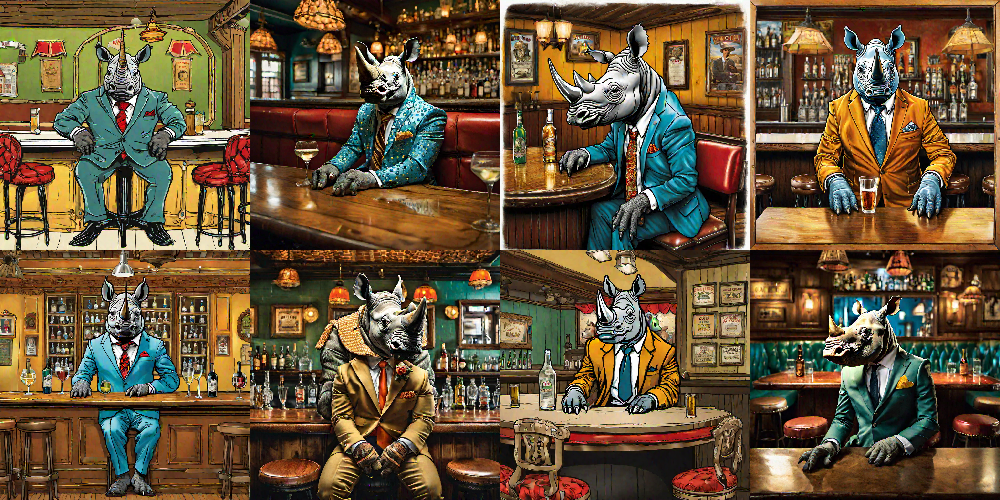

In [19]:
image_grid(images, 2, len(images)//2)

Some of these look more like illustrations than the previous version without the projection version of the text encoder. Or is it because the 0.9 vs 1.0 weights? To be investigated.